In [11]:
# Load a Mat file from dataset/

import scipy.io as sio
import numpy as np
import matplotlib.pyplot as plt

# Load the data
data = sio.loadmat('/home/ishwar/Documents/epilepsy-detection-main/dataset/theta_A_W_uni11_100ms_054.mat'   )

In [12]:
data['W'].shape

(10, 10, 2437)

In [13]:
# print the first 10 x 10 matrix in 10 x 10 x 2347 data
print(data['W'][:,:,0])


[[0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.99670579 0.
  1.         0.         0.         0.91761628]
 [0.         0.         0.         0.99670579 0.         0.
  0.96944707 0.         0.90006874 0.9565217 ]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.99735901 0.97366279]
 [0.         0.         0.         1.         0.96944707 0.
  0.         0.         0.         0.92133768]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.         0.        ]
 [0.         0.         0.         0.         0.90006874 0.99735901
  0.         0.         0.         0.98938292]
 [0.         0.         0.   

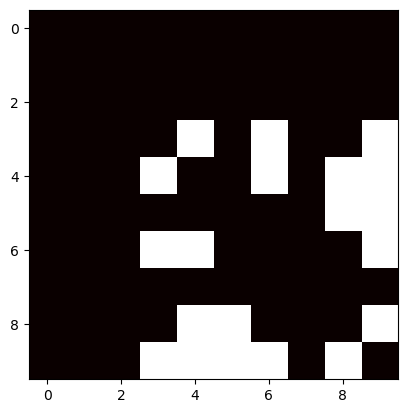

In [14]:
# view it in a heatmap
plt.imshow(data['A'][:,:,0], cmap='hot', interpolation='nearest')

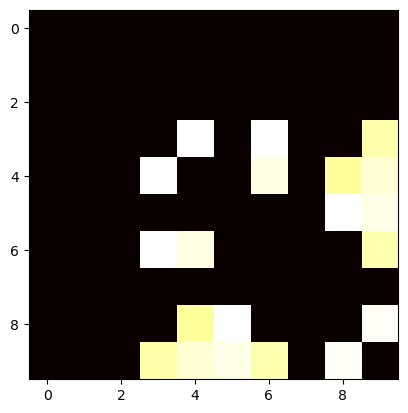

In [6]:
# view it in a heatmap
plt.imshow(data['W'][:,:,0], cmap='hot', interpolation='nearest')

In [15]:
import networkx as nx

def network_analysis(adjacency_matrix):
    G = nx.from_numpy_array(adjacency_matrix)

    # Clustering coefficient
    clustering_coefficient = np.array(list(nx.clustering(G).values()))

    # Degree centrality
    degree_centrality = np.array(list(nx.degree_centrality(G).values()))

    # Betweenness centrality
    betweenness_centrality = np.array(list(nx.betweenness_centrality(G).values()))

    # Closeness centrality
    closeness_centrality = np.array(list(nx.closeness_centrality(G).values()))

    # Eigenvector centrality
    try: 
        eigenvector_centrality = np.array(list(nx.eigenvector_centrality(G).values()))
        eigenvector_centralities = np.array(list(nx.eigenvector_centrality(G).values()))
    except:
        eigenvector_centrality = np.zeros(len(degree_centrality))
        eigenvector_centralities = np.zeros(len(degree_centrality))


    # PageRank
    pagerank = np.array(list(nx.pagerank(G).values()))

    # Katz centrality
    alpha = 0.1  # Damping factor
    katz_centrality = np.array(list(nx.katz_centrality_numpy(G, alpha=alpha).values()))

    # Degree distribution
    degree_distribution = np.array(list(dict(G.degree()).values()))

    # Assortativity coefficient
    assortativity_coefficient = np.array([nx.degree_assortativity_coefficient(G)])

    # Reciprocity
    reciprocity = np.array([nx.overall_reciprocity(G)])

    # Community detection
    # Example using modularity-based community detection
    communities = nx.community.greedy_modularity_communities(G)

    # Centrality distributions
    degree_centralities = np.array(list(nx.degree_centrality(G).values()))
    betweenness_centralities = np.array(list(nx.betweenness_centrality(G).values()))
    closeness_centralities = np.array(list(nx.closeness_centrality(G).values()))

    print("Clustering Coefficient:", clustering_coefficient)
    print("Degree Centrality:", degree_centrality)
    print("Betweenness Centrality:", betweenness_centrality)
    print("Closeness Centrality:", closeness_centrality)
    # print("Eigenvector Centrality:", eigenvector_centrality)
    print("PageRank:", pagerank)
    print("Katz Centrality:", katz_centrality)
    print("Degree Distribution:", degree_distribution)
    print("Assortativity Coefficient:", assortativity_coefficient)
    print("Reciprocity:", reciprocity)
    print("Communities:", communities)
    print("Degree Centrality Distribution:", degree_centralities)
    print("Betweenness Centrality Distribution:", betweenness_centralities)
    print("Closeness Centrality Distribution:", closeness_centralities)
    print("Eigenvector Centrality Distribution:", eigenvector_centralities)

    return_dict = {
        "clustering_coefficient": clustering_coefficient,
        "degree_centrality": degree_centrality,
        "betweenness_centrality": betweenness_centrality,
        "closeness_centrality": closeness_centrality,
        "eigenvector_centrality": eigenvector_centrality,
        "pagerank": pagerank,
        "katz_centrality": katz_centrality,
        "degree_distribution": degree_distribution,
        "assortativity_coefficient": assortativity_coefficient,
        "reciprocity": reciprocity,
        "communities": communities,
        "degree_centralities": degree_centralities,
        "betweenness_centralities": betweenness_centralities,
        "closeness_centralities": closeness_centralities,
        "eigenvector_centralities": eigenvector_centralities
    }

    return return_dict


network_analysis(data['A'][:,:,0])

Clustering Coefficient: [0.         0.         0.         1.         0.66666667 1.
 1.         0.         0.66666667 0.5       ]
Degree Centrality: [0.         0.         0.         0.33333333 0.44444444 0.22222222
 0.33333333 0.         0.33333333 0.55555556]
Betweenness Centrality: [0.         0.         0.         0.         0.02777778 0.
 0.         0.         0.01388889 0.09722222]
Closeness Centrality: [0.         0.         0.         0.3968254  0.46296296 0.34722222
 0.3968254  0.         0.3968254  0.55555556]
PageRank: [0.02272746 0.02272746 0.02272746 0.13629869 0.17699465 0.09975902
 0.13629869 0.02272746 0.14007832 0.21966079]
Katz Centrality: [0.23613269 0.23613269 0.23613269 0.35038253 0.38188481 0.31180831
 0.35038253 0.23613269 0.34652511 0.41023102]
Degree Distribution: [0 0 0 3 4 2 3 0 3 5]
Assortativity Coefficient: [-0.38297872]
Reciprocity: [0.]
Communities: [frozenset({3, 4, 6}), frozenset({8, 9, 5}), frozenset({0}), frozenset({1}), frozenset({2}), frozenset({7})

{'clustering_coefficient': array([0.        , 0.        , 0.        , 1.        , 0.66666667,
        1.        , 1.        , 0.        , 0.66666667, 0.5       ]),
 'degree_centrality': array([0.        , 0.        , 0.        , 0.33333333, 0.44444444,
        0.22222222, 0.33333333, 0.        , 0.33333333, 0.55555556]),
 'betweenness_centrality': array([0.        , 0.        , 0.        , 0.        , 0.02777778,
        0.        , 0.        , 0.        , 0.01388889, 0.09722222]),
 'closeness_centrality': array([0.        , 0.        , 0.        , 0.3968254 , 0.46296296,
        0.34722222, 0.3968254 , 0.        , 0.3968254 , 0.55555556]),
 'eigenvector_centrality': array([2.69123483e-10, 2.69123483e-10, 2.69123483e-10, 3.94581016e-01,
        4.72532825e-01, 2.49254723e-01, 3.94581016e-01, 2.69123483e-10,
        3.53464875e-01, 5.27502642e-01]),
 'pagerank': array([0.02272746, 0.02272746, 0.02272746, 0.13629869, 0.17699465,
        0.09975902, 0.13629869, 0.02272746, 0.14007832, 0.2

In [17]:
# network_metrics_timeseries = []
# for i in range(data['W'].shape[2]):
#     network_metrics_timeseries.append(network_analysis(data['A'][:,:,i]))

# load network metrics timeseries
network_metrics_timeseries = np.load('network_metrics_timeseries.npy', allow_pickle=True)



In [ ]:
# Save the network metrics timeseries
# np.save('network_metrics_timeseries.npy', network_metrics_timeseries)



In [18]:
len(network_metrics_timeseries)

2437

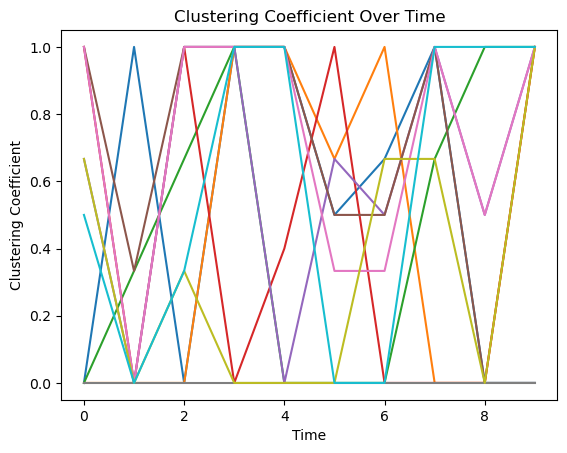

In [19]:
# Plot the clustering coefficient over time
clustering_coefficient = np.array([network_metrics['clustering_coefficient'] for network_metrics in network_metrics_timeseries[:10]])
plt.plot(clustering_coefficient)
plt.xlabel('Time')
plt.ylabel('Clustering Coefficient')
plt.title('Clustering Coefficient Over Time')

plt.show()

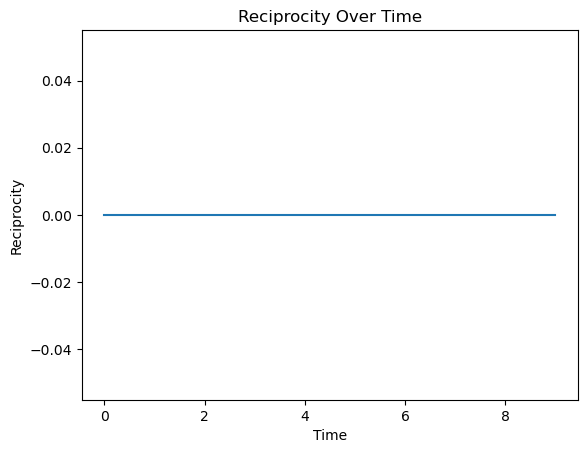

In [20]:
# plot reciprocity over time
reciprocity = np.array([network_metrics['reciprocity'] for network_metrics in network_metrics_timeseries[:10]])
plt.plot(reciprocity)
plt.xlabel('Time')
plt.ylabel('Reciprocity')
plt.title('Reciprocity Over Time')

plt.show()

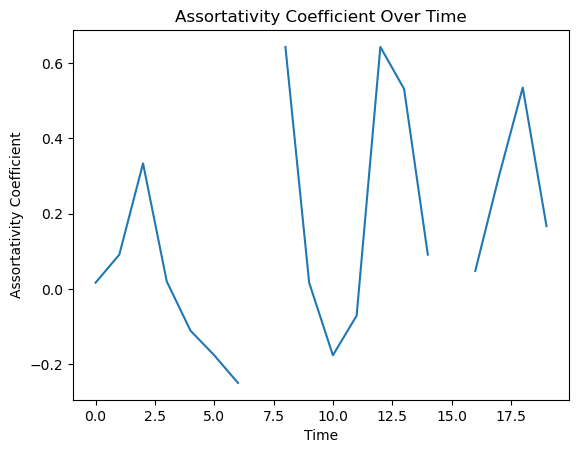

In [21]:
# plot assortativity coefficient over time
assortativity_coefficient = np.array([network_metrics['assortativity_coefficient'] for network_metrics in network_metrics_timeseries[570:590]])
plt.plot(assortativity_coefficient)
plt.xlabel('Time')
plt.ylabel('Assortativity Coefficient')
plt.title('Assortativity Coefficient Over Time')

plt.show()


<Figure size 640x480 with 0 Axes>

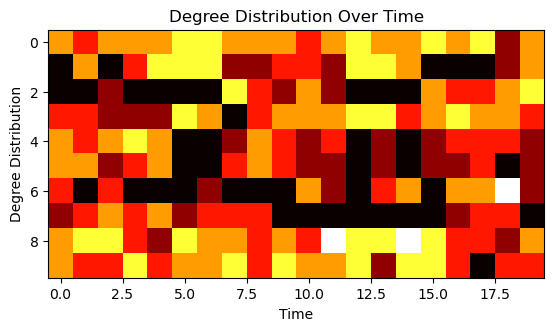

<Figure size 640x480 with 0 Axes>

In [22]:
# plot degree distribution over time as a heatmap (each row is a time point) 10 x 2347

degree_distribution = np.array([network_metrics['degree_distribution'] for network_metrics in network_metrics_timeseries[550:570]])

# Take the transpose
degree_distribution = degree_distribution.T

plt.imshow(degree_distribution, cmap='hot', interpolation='nearest')
plt.xlabel('Time')
plt.ylabel('Degree Distribution')
plt.title('Degree Distribution Over Time')

# scale the plot well, increase the figure size
plt.figure()

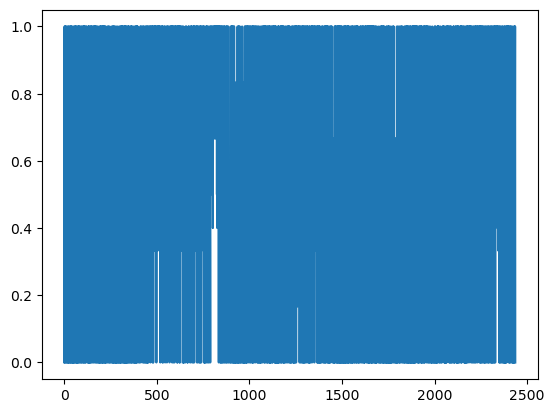

In [ ]:
# plot clustering coefficient of the first node over time
clustering_coefficient = np.array([network_metrics['clustering_coefficient'][0] for network_metrics in network_metrics_timeseries])

# plot the clustering coefficient of the first node over time
plt.plot(clustering_coefficient)


In [23]:
import plotly.graph_objects as go

# Assuming you have imported necessary libraries and defined 'clustering_coefficient'
clustering_coefficient = np.array([network_metrics['clustering_coefficient'][9] for network_metrics in network_metrics_timeseries])

# scale the values to be between 0 and 100
clustering_coefficient = np.array([value * 100 for value in clustering_coefficient])

# Create a Plotly figure
fig = go.Figure()

# Add scatter plot with the clustering coefficient data
fig.add_trace(go.Scatter(x=np.arange(len(clustering_coefficient)), y=clustering_coefficient, mode='lines'))

# Update layout for better visualization
fig.update_layout(title='Clustering Coefficient of the First Node Over Time',
                  xaxis_title='Time',
                  yaxis_title='Clustering Coefficient',
                  xaxis=dict(type='linear', autorange=True),
                  yaxis=dict(type='linear', autorange=True))

# put two dotted line at 250 mark from either side
fig.add_shape(type='line',
              x0=250, y0=0, x1=250, y1=100,
              line=dict(color='red', width=1, dash='dot'))

# put another line at 250 mark from right
fig.add_shape(type='line',
              x0=len(degree_distribution) - 250, y0=0, x1=len(degree_distribution) - 250, y1=100,
              line=dict(color='red', width=1, dash='dot'))


# Show the plot
fig.show()

In [35]:

# Assuming you have imported necessary libraries and defined 'clustering_coefficient'
degree_distribution = np.array([network_metrics['degree_distribution'][2] for network_metrics in network_metrics_timeseries])


# Create a Plotly figure
fig = go.Figure()

# Add scatter plot with the clustering coefficient data
fig.add_trace(go.Scatter(x=np.arange(len(degree_distribution)), y=degree_distribution, mode='lines'))

# Update layout for better visualization
fig.update_layout(title='degree of the imp Node Over Time',
                  xaxis_title='Time',
                  yaxis_title='degree',
                  xaxis=dict(type='linear', autorange=True),
                  yaxis=dict(type='linear', autorange=True),
                  width=1000,)


# put two dotted line at 250 mark from either side
fig.add_shape(type='line',
              x0=250, y0=0, x1=250, y1=6,
              line=dict(color='red', width=1, dash='dot'))

# put another line at 250 mark from right
fig.add_shape(type='line',
              x0=len(degree_distribution) - 250, y0=0, x1=len(degree_distribution) - 250, y1=6,
              line=dict(color='red', width=1, dash='dot'))


# Show the plot
fig.show()

In [36]:

# Assuming you have imported necessary libraries and defined 'clustering_coefficient'
eigenvector_centrality = np.array([network_metrics['eigenvector_centrality'][2] for network_metrics in network_metrics_timeseries])


# Create a Plotly figure
fig = go.Figure()

# Add scatter plot with the clustering coefficient data
fig.add_trace(go.Scatter(x=np.arange(len(eigenvector_centrality)), y=eigenvector_centrality, mode='lines'))

# Update layout for better visualization
fig.update_layout(title='Eigen-vector centrality of the imp Node Over Time',
                  xaxis_title='Time',
                  yaxis_title='Eigen-vector centrality',
                  xaxis=dict(type='linear', autorange=True),
                  yaxis=dict(type='linear', autorange=True),
                  width=1000, )


# put two dotted line at 250 mark from either side
fig.add_shape(type='line',
              x0=250, y0=0, x1=250, y1=0.75,
              line=dict(color='red', width=1, dash='dot'))

# put another line at 250 mark from right
fig.add_shape(type='line',
              x0=len(degree_distribution) - 250, y0=0, x1=len(degree_distribution) - 250, y1=0.75,
              line=dict(color='red', width=1, dash='dot'))


# Show the plot
fig.show()

In [38]:

# Assuming you have imported necessary libraries and defined 'clustering_coefficient'
katz_centrality = np.array([network_metrics['katz_centrality'][2] for network_metrics in network_metrics_timeseries])


# Create a Plotly figure
fig = go.Figure()

# Add scatter plot with the clustering coefficient data
fig.add_trace(go.Scatter(x=np.arange(len(katz_centrality)), y=katz_centrality, mode='lines'))

# Update layout for better visualization
fig.update_layout(title='Katz centrality of the important node Over Time',
                  xaxis_title='Time',
                  yaxis_title='Katz centrality',
                  xaxis=dict(type='linear', autorange=True),
                  yaxis=dict(type='linear', autorange=True),
                  width=1000, )


# put two dotted line at 250 mark from either side
fig.add_shape(type='line',
              x0=250, y0=0.2, x1=250, y1=0.5,
              line=dict(color='red', width=1, dash='dot'))

# put another line at 250 mark from right
fig.add_shape(type='line',
              x0=len(degree_distribution) - 250, y0=0.2, x1=len(degree_distribution) - 250, y1=0.5,
              line=dict(color='red', width=1, dash='dot'))


# Show the plot
fig.show()

,Unnamed: 0,b'SEEG TBAL1',b'SEEG TBAL2',b'SEEG TBAL3',b'SEEG TBAL4',b'SEEG TBAR1',b'SEEG TBAR2',b'SEEG TBAR3',b'SEEG TBAR4',b'SEEG TBPL1',...,b'SEEG TR01',b'SEEG TR02',b'SEEG TR03',b'SEEG TR04',b'SEEG TR05',b'SEEG TR06',b'SEEG TR07',b'SEEG TR08',b'SEEG TR09',b'SEEG TR10'
0,0,-88.189181,-38.861528,3.342447,0.085348,-41.288893,-52.878770,-31.795534,-30.643043,-39.362335,...,-69.353163,34.548967,-67.862048,29.882386,-22.602084,-10.024614,-16.825385,-51.032808,-79.754703,-78.160625
1,1,-66.427346,-3.978779,13.616346,7.203048,-4.340604,-28.704077,-26.707083,-27.632993,-26.843956,...,-41.265889,58.777985,-60.194769,37.228082,-8.004054,-7.703961,-4.654403,-37.125400,-65.598179,-77.061523
2,2,-51.752453,22.908923,19.550844,9.902453,29.948795,-9.886236,-31.284047,-33.319190,-16.253523,...,-16.088356,75.090799,-57.633735,38.428658,-1.991112,-3.096230,4.452376,-27.817578,-58.731145,-78.475787
3,3,-39.745054,42.451967,26.089497,13.108031,59.635832,4.352188,-42.983920,-42.050693,-8.436850,...,5.110295,85.726277,-56.816816,34.978515,-1.462286,4.336171,13.510461,-19.320821,-53.435279,-76.415414
4,4,-27.719592,57.558765,37.269571,19.346122,80.717267,16.003924,-54.492091,-54.033154,-5.272846,...,23.194813,92.118401,-56.485258,29.289402,-1.731166,12.478442,23.159327,-9.234793,-44.921518,-67.188204


# Network Metrics

In [9]:
import os

data_dir = '/home/ishwar/Documents/epilepsy-detection-main/dataset/'

# Save the network metrics timeseries
save_dir = '/home/ishwar/Documents/epilepsy-detection-main/network_metrics_timeseries/'
# Check if the directory exists, if not create it
if not os.path.exists(save_dir):
    os.makedirs(save_dir)


for filename in os.listdir(data_dir):
    if filename.endswith('.mat'):
        # if the file exists in the directory continue
        if os.path.isfile(save_dir + filename + '_network_metrics_timeseries.npy'):
            continue

        data = sio.loadmat(data_dir + filename)
        network_metrics_timeseries = []
        for i in range(data['W'].shape[2]):
            network_metrics_timeseries.append(network_analysis(data['A'][:,:,i]))

        np.save(save_dir + filename + '_network_metrics_timeseries.npy', network_metrics_timeseries)

Clustering Coefficient: [1.  0.  1.  0.5 0.  0.4 1.  0.  1.  0. ]
Degree Centrality: [0.22222222 0.11111111 0.33333333 0.44444444 0.         0.55555556
 0.22222222 0.         0.33333333 0.        ]
Betweenness Centrality: [0.         0.         0.         0.13888889 0.         0.22222222
 0.         0.         0.         0.        ]
Closeness Centrality: [0.36363636 0.30769231 0.44444444 0.5        0.         0.57142857
 0.36363636 0.         0.44444444 0.        ]
PageRank: [0.10064474 0.05952631 0.13571514 0.18537181 0.02013423 0.22197943
 0.10064474 0.02013423 0.13571514 0.02013423]
Katz Centrality: [0.31079321 0.27657744 0.35278528 0.37792869 0.23878457 0.40929314
 0.31079321 0.23878457 0.35278528 0.23878457]
Degree Distribution: [2 1 3 4 0 5 2 0 3 0]
Assortativity Coefficient: [-0.31944444]
Reciprocity: [0.]
Communities: [frozenset({8, 1, 2, 3}), frozenset({0, 5, 6}), frozenset({4}), frozenset({7}), frozenset({9})]
Degree Centrality Distribution: [0.22222222 0.11111111 0.33333333 

In [40]:
import pandas as pd

def build_data_from_csv(filename):
    df = pd.read_csv(filename)
    #Create input, labels pairs where input is all columns except the first and output is 0 for first and last 5000 rows and 1 for the rest
    X = df.iloc[:,1:]
    y = [0]*5000 + [1]*(df.shape[0]-10000) + [0]*5000

    return X, y

In [45]:
# build data for all files in dataset folder and append to X_all and y_all. Note X_all has to be a dataframe

X_all = pd.DataFrame()
y_all = []
for file in os.listdir('../csv dataset/part 1(10 eps)-unfiltered,no ref ch, no G,F,I ch'):
    print(file)
    if file.endswith('.csv'):
        X, y = build_data_from_csv('../csv dataset/part 1(10 eps)-unfiltered,no ref ch, no G,F,I ch/' + file)
        X_all = pd.concat([X_all, X])
        y_all += y
        

uni_167_Tomic-Stoja_RMT_no-ref-ch.csv
uni_081_Schlick-Reinhard_LMT_no-ref-ch_no-G,F,I-channels.csv
uni_113_Ahmed-Nasteha-Mohamud_RMT_no-ref-ch.csv
uni_112_Ahmed-Nasteha-Mohamud_LMT_no-ref-ch.csv
uni_080_Schlick-Reinhard_LMT_no-ref-ch_no-G,F,I-channels.csv
uni_054_Heide-Astrid_LMT_no-ref-ch_no-G,F,I-channels.csv
uni_117_Senzek-Heiko_RMT_no-ref-ch_no-G,F,I-channels.csv
uni_125_Erbst-Doris_LMT_no-ref-ch_no-G,F,I-channels.csv
uni_111_Ahmed-Nasteha-Mohamud_LMT_no-ref-ch.csv
uni_140_Pott-Eberhand_RMT_no-ref-ch.csv


In [62]:
X_all.dropna(axis=1, inplace=True)

In [51]:
# Find length of the dataframe


48740

In [63]:
# Load this csv file - /home/ishwar/Documents/epilepsy-detection-main/csv dataset/part 1(10 eps)-unfiltered,no ref ch, no G,F,I ch/uni_054_Heide-Astrid_LMT_no-ref-ch_no-G,F,I-channels.csv

import pandas as pd

df = pd.read_csv('/home/ishwar/Documents/epilepsy-detection-main/csv dataset/part 1(10 eps)-unfiltered,no ref ch, no G,F,I ch/uni_054_Heide-Astrid_LMT_no-ref-ch_no-G,F,I-channels.csv')
# removed unnamed columns
df.drop(df.columns[0], axis = 1, inplace=True)
df = df[X_all.columns]
df.head()

,b'SEEG TBAL3',b'SEEG TBAL4',b'SEEG TBPL1',b'SEEG TBPL2',b'SEEG TBPL3',b'SEEG TBPL4',b'SEEG TLL01',b'SEEG TLL02',b'SEEG TLL03',b'SEEG TLL04'
0,3.342447,0.085348,-39.362335,-10.738237,15.324795,-49.298053,-90.270553,-61.634166,-51.222290,-86.740598
1,13.616346,7.203048,-26.843956,5.234174,19.277234,-31.087534,-68.389028,-59.101429,-31.188106,-61.308906
2,19.550844,9.902453,-16.253523,13.622076,25.918544,-14.426090,-47.205251,-54.990997,-6.465727,-49.986410
3,26.089497,13.108031,-8.436850,15.353887,31.675326,1.460275,-30.201283,-47.247038,13.438262,-43.524596
4,37.269571,19.346122,-5.272846,12.879427,34.073961,16.131431,-17.664217,-37.011247,29.049548,-31.918892


In [64]:
#Plot the colums over time using plotly

import plotly.graph_objects as go

fig = go.Figure()
for column in df.columns:
    fig.add_trace(go.Scatter(x=df.index, y=df[column], mode='lines', name=column))

fig.update_layout(title='EEG Data Over Time',
                    xaxis_title='Time',
                    yaxis_title='EEG Data',
                    xaxis=dict(type='linear', autorange=True),
                    yaxis=dict(type='linear', autorange=True),
                    width=1000, height=500)


# put two dotted line at 250 mark from either side
fig.add_shape(type='line',
              x0=5000, y0=-2200, x1=5000, y1=2200,
              line=dict(color='red', width=1, dash='dot'))

# put another line at 250 mark from right
fig.add_shape(type='line',
              x0=len(df) - 5000, y0=-2200, x1=len(df) - 5000, y1=2200,
              line=dict(color='red', width=1, dash='dot'))

fig.show()
